In [1]:
!pip install tensorflow opencv-python matplotlib

Defaulting to user installation because normal site-packages is not writeable


In [2]:
!pip install tensorflow opencv-python matplotlib

Defaulting to user installation because normal site-packages is not writeable


In [3]:
!pip list


Package                       Version
----------------------------- ---------------
absl-py                       2.0.0
aiobotocore                   2.4.2
aiofiles                      22.1.0
aiohttp                       3.8.3
aioitertools                  0.7.1
aiosignal                     1.2.0
aiosqlite                     0.18.0
alabaster                     0.7.12
altair                        5.1.1
anaconda-anon-usage           0.4.2
anaconda-catalogs             0.2.0
anaconda-client               1.12.0
anaconda-cloud-auth           0.1.3
anaconda-navigator            2.5.3
anaconda-project              0.11.1
anyio                         3.5.0
appdirs                       1.4.4
argon2-cffi                   21.3.0
argon2-cffi-bindings          21.2.0
arrow                         1.2.3
astroid                       2.14.2
astropy                       5.1
asttokens                     2.4.1
astunparse                    1.6.3
async-timeout                 4.0.2
atomicwrit

In [4]:
import tensorflow as tf
import os

In [5]:
# Avoid OOM errors by setting GPU Memory Consumption Growth
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus: 
    tf.config.experimental.set_memory_growth(gpu, True)

In [6]:
tf.config.list_physical_devices('GPU')

[]

In [7]:
import os
import warnings
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

warnings.filterwarnings("ignore")

In [8]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from PIL import Image 
from skimage.io import imread
import cv2

K.clear_session()

In [9]:
img = plt.imread('C:/input/indian-food-classification/dataset/Dataset/train/pizza/033.jpg')
dims = np.shape(img)
matrix = np.reshape(img, (dims[0] * dims[1], dims[2]))
print(np.shape(matrix))

(680900, 3)


Image shape ->  (619, 1100)
Color channels ->  3
Min color depth : 0, Max color depth 255


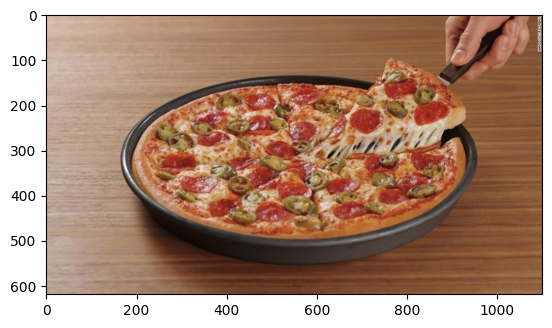

In [10]:
plt.imshow(img)
print("Image shape -> ",dims[:2])
print("Color channels -> ",dims[2])
print("Min color depth : {}, Max color depth {}".format(np.min(img),np.max(img)))

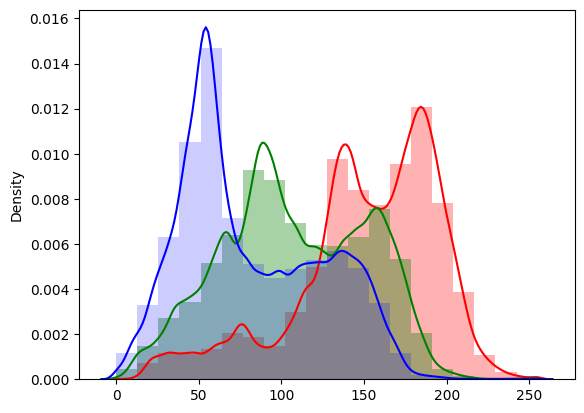

In [11]:
sns.distplot(matrix[:,0], bins=20,color="red",hist_kws=dict(alpha=0.3))
sns.distplot(matrix[:,1], bins=20,color="green",hist_kws=dict(alpha=0.35))
sns.distplot(matrix[:,2], bins=20,color="blue",hist_kws=dict(alpha=0.2))
plt.show()

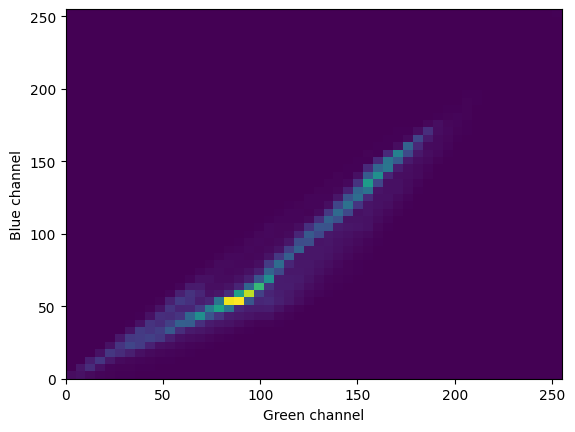

In [12]:
_ = plt.hist2d(matrix[:,1], matrix[:,2], bins=(50,50))
plt.xlabel('Green channel')
plt.ylabel('Blue channel')
plt.show()

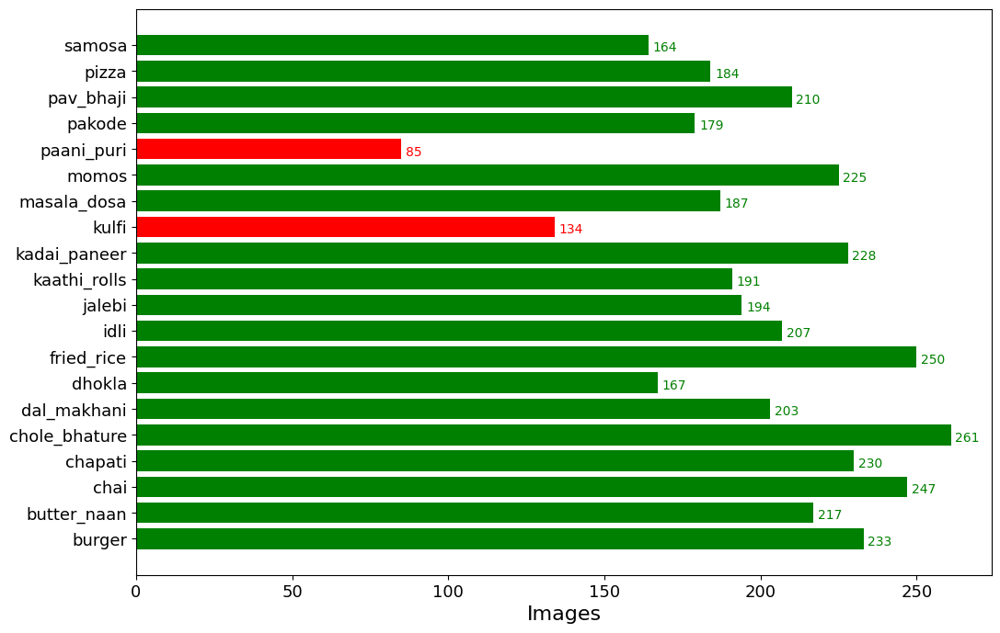

In [13]:
main='C:/input/indian-food-classification/dataset/Dataset/train/'

data=dict()

for i in os.listdir(main):
    sub_dir=os.path.join(main,i)
    count=len(os.listdir(sub_dir))
    data[i]=count

keys = data.keys()
values = data.values()

colors=["red" if x<= 150 else "green" for x in values]

fig, ax = plt.subplots(figsize=(12,8))
y_pos=np.arange(len(values))
plt.barh(y_pos,values,align='center',color=colors)
for i, v in enumerate(values):
    ax.text(v+1.4, i-0.25, str(v), color=colors[i])
ax.set_yticks(y_pos)
ax.set_yticklabels(keys)
ax.set_xlabel('Images',fontsize=16)
plt.xticks(color='black',fontsize=13)
plt.yticks(fontsize=13)
plt.show()

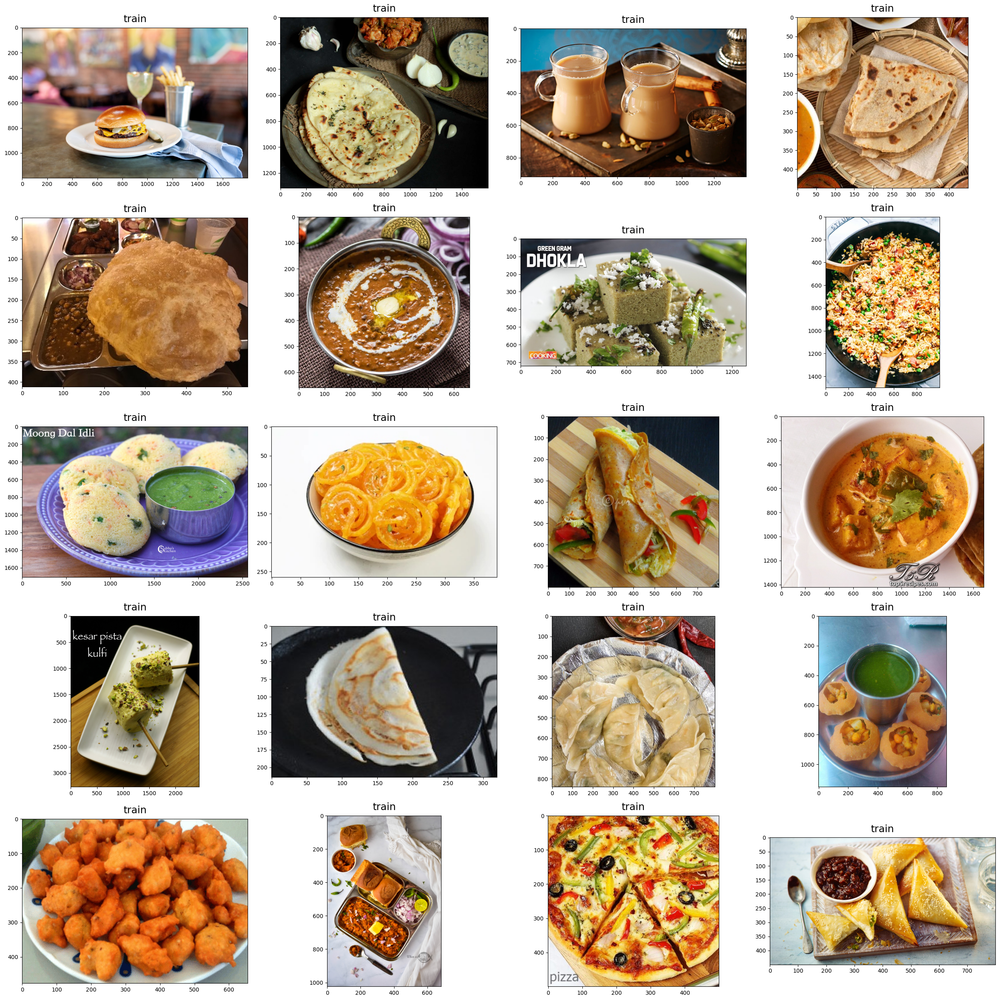

In [14]:
import random

train_folder = "C:/input/indian-food-classification/dataset/Dataset/train/"
images = []

for food_folder in sorted(os.listdir(train_folder)):
    food_items = os.listdir(train_folder + '/' + food_folder)
    food_selected = np.random.choice(food_items)
    images.append(os.path.join(train_folder,food_folder,food_selected))
                                     
fig=plt.figure(1, figsize=(25, 25))

for subplot,image_ in enumerate(images):
    category=image_.split('/')[-2]
    imgs = plt.imread(image_)
    a,b,c=imgs.shape
    fig=plt.subplot(5, 4, subplot+1)
    fig.set_title(category, pad = 10,size=18)
    plt.imshow(imgs)
    
plt.tight_layout()

In [15]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

n_classes = 20
batch_size = 32
img_width, img_height = 299, 299

train_data_dir = 'C:/input/indian-food-classification/dataset/Dataset/train/'

# Data Augmentation with ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

val_data_dir = 'C:/input/indian-food-classification/dataset/Dataset/val/'

val_datagen = ImageDataGenerator(rescale=1. / 255)

val_generator = val_datagen.flow_from_directory(
    val_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 3996 images belonging to 20 classes.
Found 1250 images belonging to 20 classes.


In [16]:
class_map = train_generator.class_indices
class_map

{'burger': 0,
 'butter_naan': 1,
 'chai': 2,
 'chapati': 3,
 'chole_bhature': 4,
 'dal_makhani': 5,
 'dhokla': 6,
 'fried_rice': 7,
 'idli': 8,
 'jalebi': 9,
 'kaathi_rolls': 10,
 'kadai_paneer': 11,
 'kulfi': 12,
 'masala_dosa': 13,
 'momos': 14,
 'paani_puri': 15,
 'pakode': 16,
 'pav_bhaji': 17,
 'pizza': 18,
 'samosa': 19}

In [17]:
print(tf.__version__)
print(tf.test.gpu_device_name())

2.15.0



In [18]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
# from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
# from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten

from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Dense, Dropout

from tensorflow.keras import regularizers
from tensorflow.keras.regularizers import l2

from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger

nb_train_samples = 3583 
nb_validation_samples = 1089

inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128,activation='relu')(x)
x = Dropout(0.2)(x)

predictions = Dense(n_classes,kernel_regularizer=regularizers.l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(lr=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])
checkpointer = ModelCheckpoint(filepath='v1_inceptionV3', verbose=1, save_best_only=True)
csv_logger = CSVLogger('history_v1_inceptionV3.log')

history = model.fit_generator(train_generator,
                    steps_per_epoch = nb_train_samples // batch_size,
                    validation_data=val_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=20,
                    verbose=1,
                    callbacks=[csv_logger, checkpointer])

Epoch 1/20



111/111 [==============================] - ETA: 0s - loss: 1.2762 - accuracy: 0.6905
Epoch 1: val_loss improved from inf to 1.63365, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 993s 9s/step - loss: 1.2762 - accuracy: 0.6905 - val_loss: 1.6337 - val_accuracy: 0.5708
Epoch 2/20
111/111 [==============================] - ETA: 0s - loss: 0.5452 - accuracy: 0.8875
Epoch 2: val_loss did not improve from 1.63365
111/111 [==============================] - 1075s 10s/step - loss: 0.5452 - accuracy: 0.8875 - val_loss: 2.6650 - val_accuracy: 0.4035
Epoch 3/20
111/111 [==============================] - ETA: 0s - loss: 0.4217 - accuracy: 0.9098
Epoch 3: val_loss improved from 1.63365 to 0.77458, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 775s 7s/step - loss: 0.4217 - accuracy: 0.9098 - val_loss: 0.7746 - val_accuracy: 0.8079
Epoch 4/20
111/111 [==============================] - ETA: 0s - loss: 0.3163 - accuracy: 0.9405  
Epoch 4: val_loss did not improve from 0.77458
111/111 [==============================] - 7946s 72s/step - loss: 0.3163 - accuracy: 0.9405 - val_loss: 1.5375 - val_accuracy: 0.6167
Epoch 5/20
111/111 [==============================] - ETA: 0s - loss: 0.2463 - accuracy: 0.9546
Epoch 5: val_loss did not improve from 0.77458
111/111 [==============================] - 1143s 10s/step - loss: 0.2463 - accuracy: 0.9546 - val_loss: 0.8979 - val_accuracy: 0.7730
Epoch 6/20
111/111 [==============================] - ETA: 0s - loss: 0.2085 - accuracy: 0.9636 
Epoch 6: val_loss improved from 0.77458 to 0.68159, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 2182s 20s/step - loss: 0.2085 - accuracy: 0.9636 - val_loss: 0.6816 - val_accuracy: 0.8520
Epoch 7/20
111/111 [==============================] - ETA: 0s - loss: 0.1855 - accuracy: 0.9665
Epoch 7: val_loss did not improve from 0.68159
111/111 [==============================] - 907s 8s/step - loss: 0.1855 - accuracy: 0.9665 - val_loss: 0.6834 - val_accuracy: 0.8281
Epoch 8/20
111/111 [==============================] - ETA: 0s - loss: 0.1473 - accuracy: 0.9772
Epoch 8: val_loss did not improve from 0.68159
111/111 [==============================] - 937s 8s/step - loss: 0.1473 - accuracy: 0.9772 - val_loss: 0.7354 - val_accuracy: 0.8097
Epoch 9/20
111/111 [==============================] - ETA: 0s - loss: 0.1345 - accuracy: 0.9775
Epoch 9: val_loss improved from 0.68159 to 0.51124, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 957s 9s/step - loss: 0.1345 - accuracy: 0.9775 - val_loss: 0.5112 - val_accuracy: 0.8778
Epoch 10/20
111/111 [==============================] - ETA: 0s - loss: 0.1356 - accuracy: 0.9797
Epoch 10: val_loss improved from 0.51124 to 0.49669, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 978s 9s/step - loss: 0.1356 - accuracy: 0.9797 - val_loss: 0.4967 - val_accuracy: 0.8750
Epoch 11/20
111/111 [==============================] - ETA: 0s - loss: 0.1247 - accuracy: 0.9794
Epoch 11: val_loss did not improve from 0.49669
111/111 [==============================] - 920s 8s/step - loss: 0.1247 - accuracy: 0.9794 - val_loss: 0.6321 - val_accuracy: 0.8456
Epoch 12/20
111/111 [==============================] - ETA: 0s - loss: 0.1153 - accuracy: 0.9789 
Epoch 12: val_loss improved from 0.49669 to 0.39059, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 2025s 18s/step - loss: 0.1153 - accuracy: 0.9789 - val_loss: 0.3906 - val_accuracy: 0.9062
Epoch 13/20
111/111 [==============================] - ETA: 0s - loss: 0.1005 - accuracy: 0.9845 
Epoch 13: val_loss did not improve from 0.39059
111/111 [==============================] - 3431s 31s/step - loss: 0.1005 - accuracy: 0.9845 - val_loss: 0.6434 - val_accuracy: 0.8410
Epoch 14/20
111/111 [==============================] - ETA: 0s - loss: 0.0934 - accuracy: 0.9856 
Epoch 14: val_loss did not improve from 0.39059
111/111 [==============================] - 1740s 16s/step - loss: 0.0934 - accuracy: 0.9856 - val_loss: 0.5185 - val_accuracy: 0.8640
Epoch 15/20
111/111 [==============================] - ETA: 0s - loss: 0.0823 - accuracy: 0.9873 
Epoch 15: val_loss improved from 0.39059 to 0.31221, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 3118s 28s/step - loss: 0.0823 - accuracy: 0.9873 - val_loss: 0.3122 - val_accuracy: 0.9200
Epoch 16/20
111/111 [==============================] - ETA: 0s - loss: 0.0665 - accuracy: 0.9930 
Epoch 16: val_loss did not improve from 0.31221
111/111 [==============================] - 3440s 31s/step - loss: 0.0665 - accuracy: 0.9930 - val_loss: 0.3566 - val_accuracy: 0.9145
Epoch 17/20
111/111 [==============================] - ETA: 0s - loss: 0.0647 - accuracy: 0.9924 
Epoch 17: val_loss improved from 0.31221 to 0.26950, saving model to v1_inceptionV3
INFO:tensorflow:Assets written to: v1_inceptionV3\assets


INFO:tensorflow:Assets written to: v1_inceptionV3\assets


111/111 [==============================] - 2263s 20s/step - loss: 0.0647 - accuracy: 0.9924 - val_loss: 0.2695 - val_accuracy: 0.9219
Epoch 18/20
111/111 [==============================] - ETA: 0s - loss: 0.0580 - accuracy: 0.9935 
Epoch 18: val_loss did not improve from 0.26950
111/111 [==============================] - 1465s 13s/step - loss: 0.0580 - accuracy: 0.9935 - val_loss: 0.4139 - val_accuracy: 0.8915
Epoch 19/20
111/111 [==============================] - ETA: 0s - loss: 0.0513 - accuracy: 0.9955 
Epoch 19: val_loss did not improve from 0.26950
111/111 [==============================] - 1564s 14s/step - loss: 0.0513 - accuracy: 0.9955 - val_loss: 0.2833 - val_accuracy: 0.9347
Epoch 20/20
111/111 [==============================] - ETA: 0s - loss: 0.0600 - accuracy: 0.9921 
Epoch 20: val_loss did not improve from 0.26950
111/111 [==============================] - 1391s 13s/step - loss: 0.0600 - accuracy: 0.9921 - val_loss: 0.2978 - val_accuracy: 0.9246


In [28]:
model.save('model_v1_inceptionV3.h5')

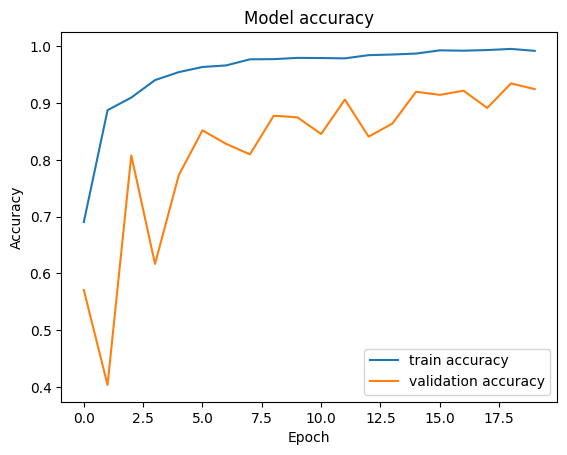

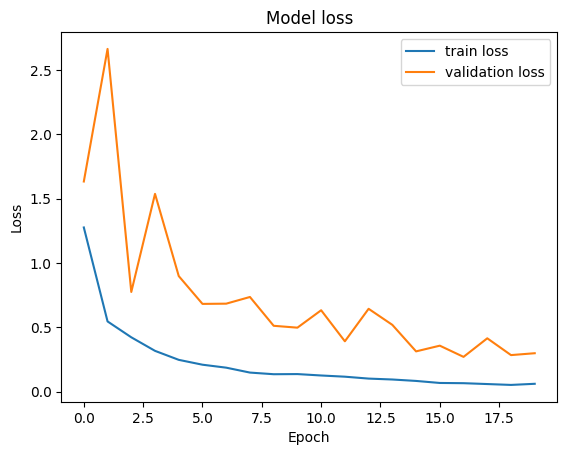

In [29]:
def plot_accuracy(history):
    
    plt.plot(history.history['accuracy'],label='train accuracy')
    plt.plot(history.history['val_accuracy'],label='validation accuracy')
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Accuracy_v1_InceptionV3')
    plt.show()
    
def plot_loss(history):
    
    plt.plot(history.history['loss'],label="train loss")
    plt.plot(history.history['val_loss'],label="validation loss")
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Loss_v1_InceptionV3')
    plt.show()
    
plot_accuracy(history)
plot_loss(history)

In [30]:
K.clear_session()
path_to_model='./model_v1_inceptionV3.h5'
print("Loading the model..")
model = load_model(path_to_model)
print("Done!")

Loading the model..
Done!


In [31]:
test_data_dir = 'C:/input/indian-food-classification/test'

test_datagen = ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 585 images belonging to 20 classes.


In [32]:
scores = model.evaluate_generator(test_generator)

print("Test Accuracy: {:.3f}".format(scores[1]))


Test Accuracy: 0.909


In [41]:
category={
    0: ['burger','Burger'], 1: ['butter_naan','Butter Naan'], 2: ['chai','Chai'],
    3: ['chapati','Chapati'], 4: ['chole_bhature','Chole Bhature'], 5: ['dal_makhani','Dal Makhani'],
    6: ['dhokla','Dhokla'], 7: ['fried_rice','Fried Rice'], 8: ['idli','Idli'], 9: ['jalegi','Jalebi'],
    10: ['kathi_rolls','Kaathi Rolls'], 11: ['kadai_paneer','Kadai Paneer'], 12: ['kulfi','Kulfi'],
    13: ['masala_dosa','Masala Dosa'], 14: ['momos','Momos'], 15: ['paani_puri','Paani Puri'],
    16: ['pakode','Pakode'], 17: ['pav_bhaji','Pav Bhaji'], 18: ['pizza','Pizza'], 19: ['samosa','Samosa']
}

def predict_image(filename,model):
    img_ = image.load_img(filename, target_size=(299, 299))
    img_array = image.img_to_array(img_)
    img_processed = np.expand_dims(img_array, axis=0) 
    img_processed /= 255.   
    
    prediction = model.predict(img_processed)
    
    index = np.argmax(prediction)
    
    plt.title("Prediction - {}".format(category[index][1]))
    plt.imshow(img_array)
    
def predict_dir(filedir,model):
    cols=5
    pos=0
    images=[]
    total_images=len(os.listdir(filedir))
    rows=total_images//cols + 1
    
    true=filedir.split('/')[-1]
    
    fig=plt.figure(1, figsize=(25, 25))
    
    for i in sorted(os.listdir(filedir)):
        images.append(os.path.join(filedir,i))
        
    for subplot,imggg in enumerate(images):
        img_ = image.load_img(imggg, target_size=(299, 299))
        img_array = image.img_to_array(img_)
        
        img_processed = np.expand_dims(img_array, axis=0) 
        
        img_processed /= 255.
        prediction = model.predict(img_processed)
        index = np.argmax(prediction)
        
        pred=category.get(index)[0]
        if pred==true:
            pos+=1
        
        fig=plt.subplot(rows, cols, subplot+1)
        fig.set_title(category.get(index)[1], pad = 10,size=18)
        plt.imshow(img_array)

    acc=pos/total_images
    print("Accuracy of Test : {:.2f} ({pos}/{total})".format(acc,pos=pos,total=total_images))
    plt.tight_layout()
        


1/1 [==============================] - 0s 392ms/step


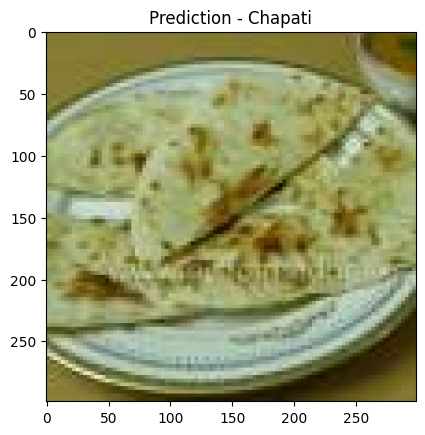

In [42]:
predict_image('C:/input/indian-food-classification/test/butter_naan/download (1).jpg',model)

1/1 [==============================] - 0s 261ms/step
Accuracy of Test : 1.00 (29/29)


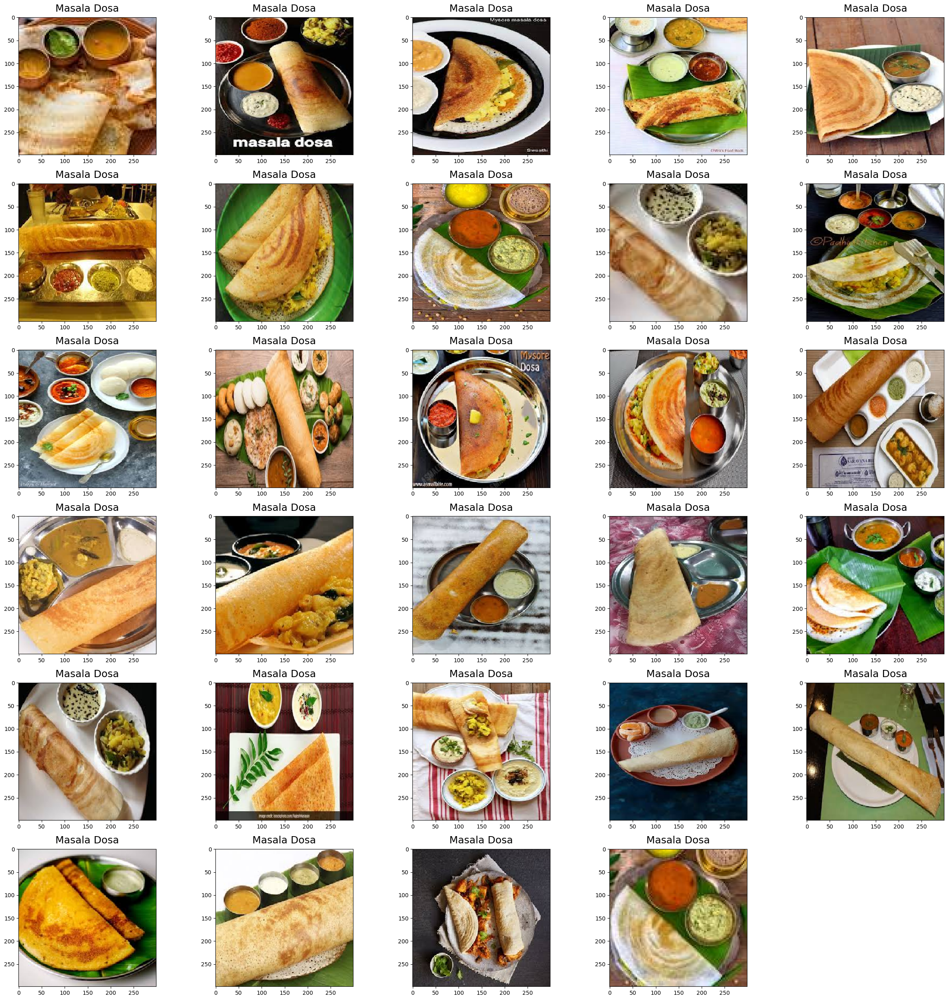

In [43]:
predict_dir("C:/input/indian-food-classification/test/masala_dosa",model)

1/1 [==============================] - 0s 333ms/step


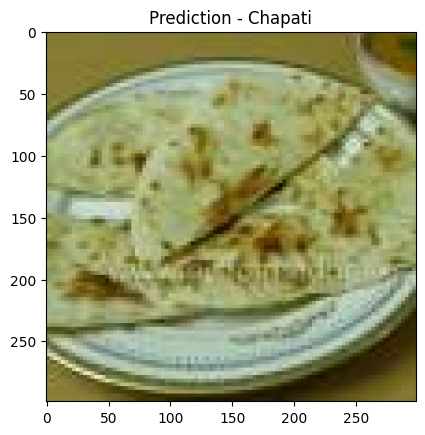

In [44]:
predict_image('C:/input/indian-food-classification/test/butter_naan/download (1).jpg',model)

1/1 [==============================] - 0s 330ms/step
Accuracy of Test : 0.89 (25/28)


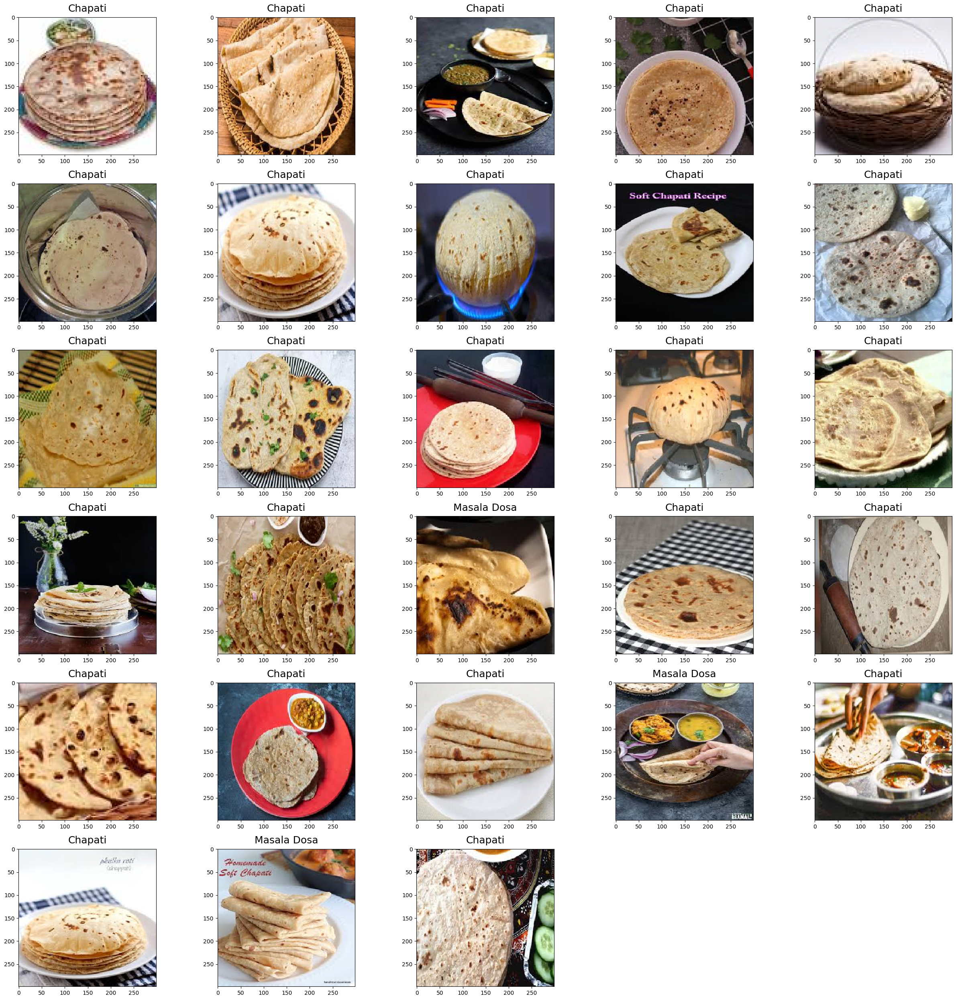

In [40]:
predict_dir("C:/input/indian-food-classification/test/chapati",model)

1/1 [==============================] - 0s 264ms/step


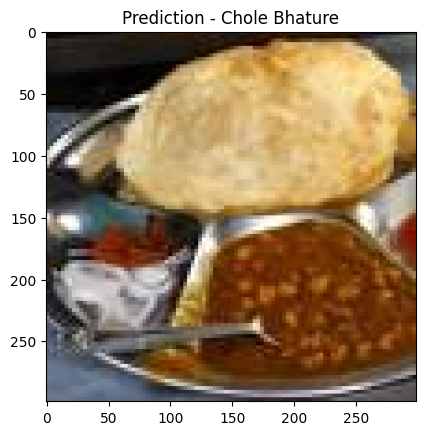

In [45]:
predict_image('C:/input/indian-food-classification/test/chole_bhature/download (1).jpg',model)

1/1 [==============================] - 0s 244ms/step


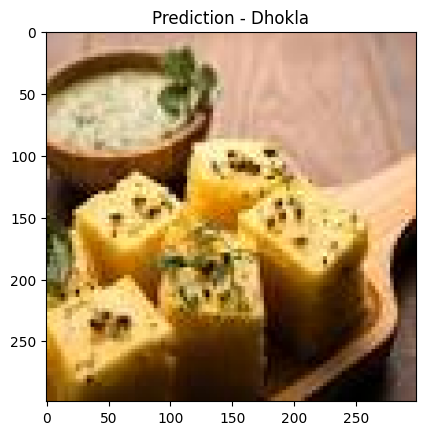

In [46]:
predict_image('C:/input/indian-food-classification/test/dhokla/download (1).jpg',model)

1/1 [==============================] - 0s 254ms/step


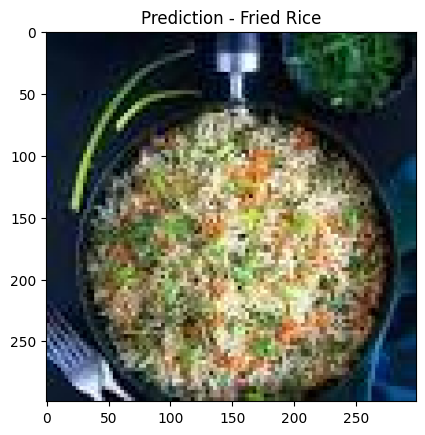

In [47]:
predict_image('C:/input/indian-food-classification/test/fried_rice/download (1).jpg',model)

1/1 [==============================] - 0s 247ms/step


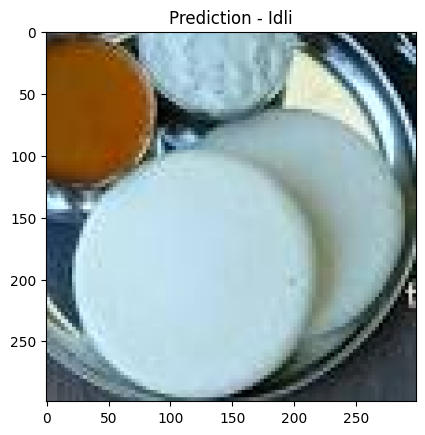

In [48]:
predict_image('C:/input/indian-food-classification/test/idli/download (1).jpg',model)

1/1 [==============================] - 0s 428ms/step


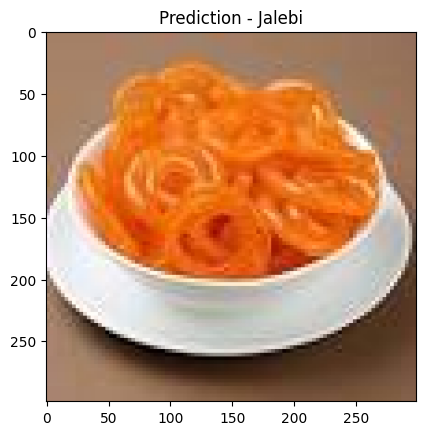

In [49]:
predict_image('C:/input/indian-food-classification/test/jalebi/download (1).jpg',model)

1/1 [==============================] - 0s 239ms/step


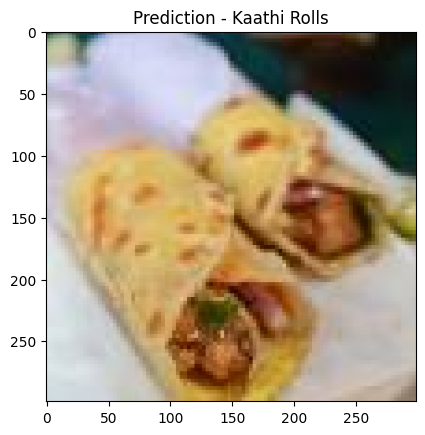

In [52]:
predict_image('C:/input/indian-food-classification/test/kaathi_rolls/download (2).jpg',model)

1/1 [==============================] - 1s 549ms/step


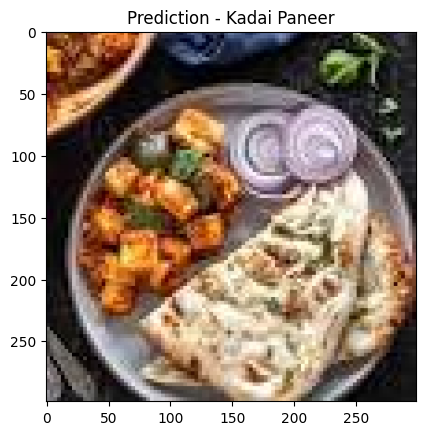

In [54]:
predict_image('C:/input/indian-food-classification/test/kadai_paneer/download (1).jpg',model)

1/1 [==============================] - 0s 246ms/step


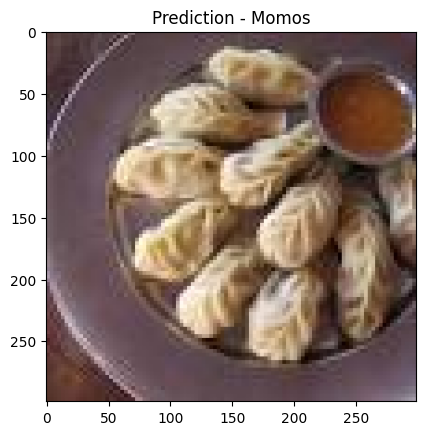

In [55]:
predict_image('C:/input/indian-food-classification/test/momos/download (1).jpg',model)

1/1 [==============================] - 0s 240ms/step


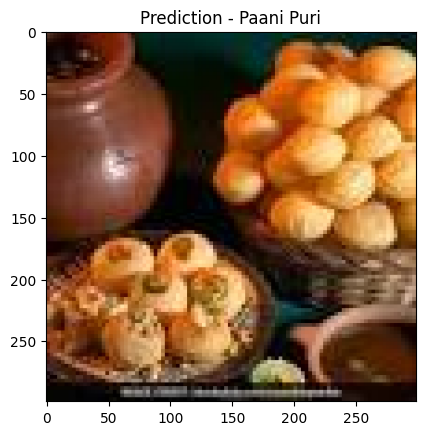

In [56]:
predict_image('C:/input/indian-food-classification/test/paani_puri/download (1).jpg',model)

In [57]:
model.save('model_v1_inceptionV3.h5')

In [63]:
from sklearn.metrics import confusion_matrix
import itertools

img_width, img_height = 299, 299

def labels_confusion_matrix():
    folder_path="C:/input/indian-food-classification/test"
    
    mapping={}
    for i,j in enumerate(sorted(os.listdir(folder_path))):
        mapping[j]=i
    
    files=[]
    real=[]
    predicted=[]

    for i in os.listdir(folder_path):
        
        true=os.path.join(folder_path,i)
        true=true.split('/')[-1]
        
        
        for j in os.listdir(os.path.join(folder_path,i)):
            
            img_ = image.load_img(os.path.join(folder_path,i,j), target_size=(img_height, img_width))
            img_array = image.img_to_array(img_)
            img_processed = np.expand_dims(img_array, axis=0)
            img_processed /= 255.
            prediction = model.predict(img_processed)
            index = np.argmax(prediction)

            predicted.append(index)
            real.append(true)
            
    return (real,predicted)

def print_confusion_matrix(real,predicted):

    cmap="viridis"
    cm_plot_labels = [i for i in range(20)]

    cm = confusion_matrix(y_true=real, y_pred=predicted)
    df_cm = pd.DataFrame(cm,cm_plot_labels,cm_plot_labels)
    sns.set(font_scale=1.1) # for label size
    plt.figure(figsize = (15,10))
    s=sns.heatmap(df_cm, annot=True,cmap=cmap) # font size
#     bottom,top=s.get_ylim()
#     s.set_ylim(bottom+0.6,top-0.6)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig('confusion_matrix.png')
    plt.show()


1/1 [==============================] - 1s 595ms/step


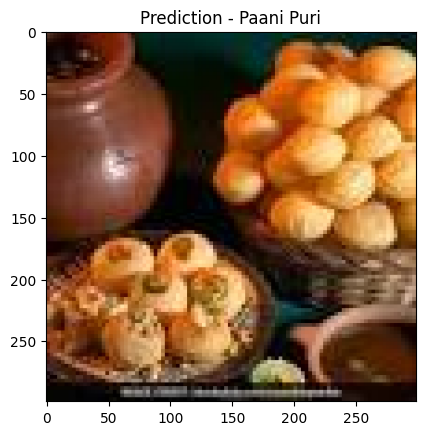

In [65]:
predict_image('C:/input/indian-food-classification/test/paani_puri/download (1).jpg',model)